# Problem Set 7

In [15]:
import matplotlib.colors as mplc
import matplotlib.patches as patches
import matplotlib.pyplot as plt
import pandas as pd
import qeds
import numpy as np

## Questions 3-5

These question uses a dataset from the [Bureau of Transportation
Statistics]([https://www.transtats.bts.gov/DL_SelectFields.asp?Table_ID=236&DB_Short_Name=On-Time](https://www.transtats.bts.gov/DL_SelectFields.asp?Table_ID=236&DB_Short_Name=On-Time))
that describes the cause for all US domestic flight delays
in November 2016. We used the same data in the previous problem set.

In [9]:
if not 'air_perf' in locals():
    air_perf = qeds.load("airline_performance_dec16") #[["CRSDepTime", "Carrier", "CarrierDelay", "ArrDelay"]];

The following questions are intentionally somewhat open-ended. For
each one, carefully choose the type of visualization you’ll create.
Put some effort into choosing colors, labels, and other
formatting.

### Question 3

Create a visualization of the relationship between airline (carrier)
and delays.

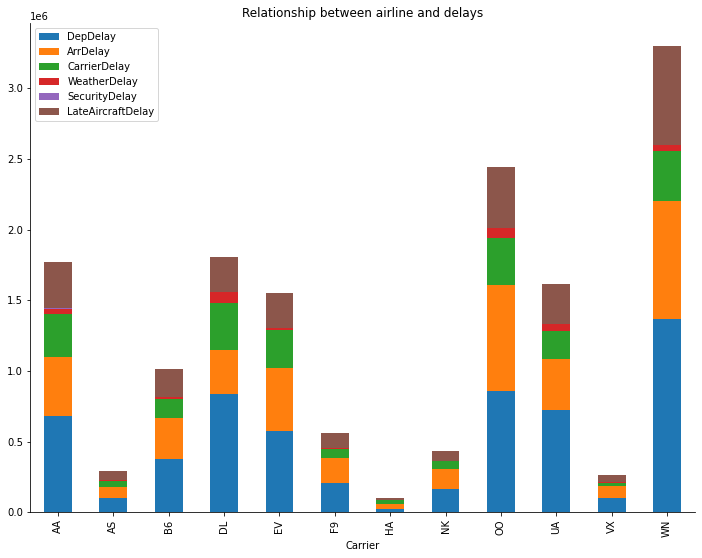

In [10]:
df_1 = air_perf.groupby('Carrier').sum()[["DepDelay" , "ArrDelay" , "CarrierDelay",  "WeatherDelay"
            ,"SecurityDelay" , "LateAircraftDelay" ]]

def bargraph1(df_1):
    fig, ax = plt.subplots(figsize=(10,8))
    df_1.plot(kind="bar", ax=ax , stacked=True , title = "Relationship between airline and delays") 
    plt.rcParams.update({'font.size': 15})
    fig.tight_layout()
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    return fig

bargraph1(df_1);

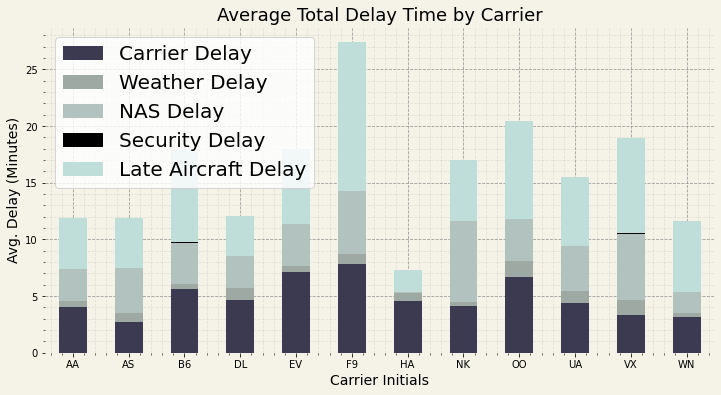

In [27]:
gbCarrier = air_perf.groupby("Carrier")

carr_delays = pd.DataFrame({
    "Carrier Delay":       gbCarrier["CarrierDelay"].mean(),
    "Weather Delay":       gbCarrier["WeatherDelay"].mean(),
    "NAS Delay":           gbCarrier["NASDelay"].mean(),
    "Security Delay":      gbCarrier["SecurityDelay"].mean(),
    "Late Aircraft Delay": gbCarrier["LateAircraftDelay"].mean(),
})


colors = ["#3b3a50", "#9fa9a3", "#b2c2bf", "#000000", "#c0ded9" ]

fig1, ax1 = plt.subplots()
carr_delays.plot.bar(stacked=True, figsize=(12, 6), ax=ax1, color=colors)

ax1.set_title("Average Total Delay Time by Carrier", fontsize=18)
ax1.set_ylabel("Avg. Delay (Minutes)", fontsize=14)
ax1.set_xlabel("Carrier Initials", fontsize=14)
plt.xticks(rotation=0, fontsize=10)
plt.yticks(rotation=0, fontsize=10)

ax1.set_axisbelow(True)
plt.grid(b=True, which='major', color='#999999', linestyle='--')
plt.minorticks_on()
plt.grid(b=True, which='minor', color='#999999', linestyle='--', alpha=0.2)

ax1.set_facecolor('#F5F3E7')
fig1.set_facecolor('#F5F3E7')


for side in ["right", "top", "left", "bottom"]:
    ax1.spines[side].set_visible(False)

Bar chart between Carrier and all the Delay type
Type 1: Each type on separate graphs


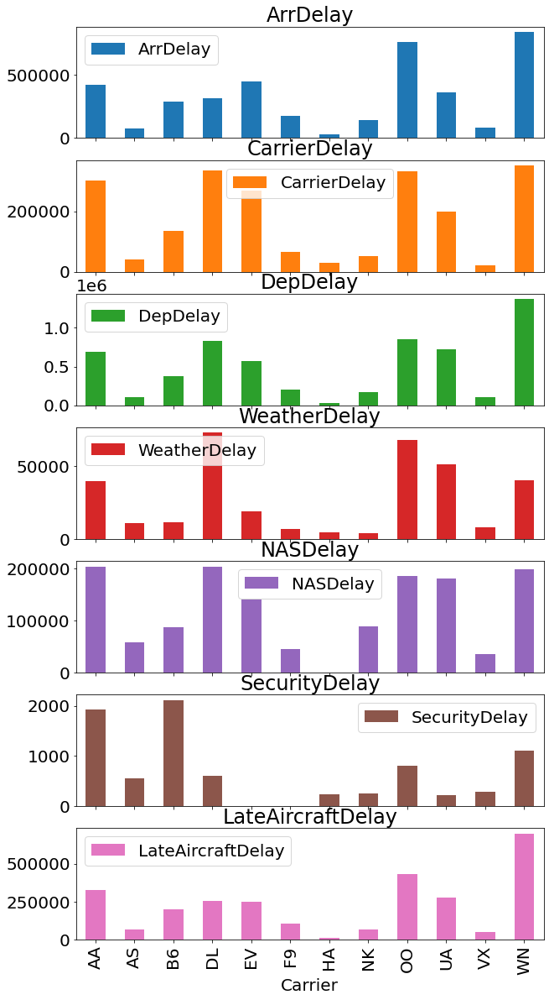

In [29]:
# Group dataframe by Carrier and only leave the information we need (all the delay info)
df = air_perf.groupby("Carrier").sum()[["ArrDelay","CarrierDelay", "DepDelay", "WeatherDelay","NASDelay","SecurityDelay","LateAircraftDelay"]]

# Plot 
print("Bar chart between Carrier and all the Delay type")
print("Type 1: Each type on separate graphs")
df.plot(kind="bar", subplots=True,figsize=(10,20));

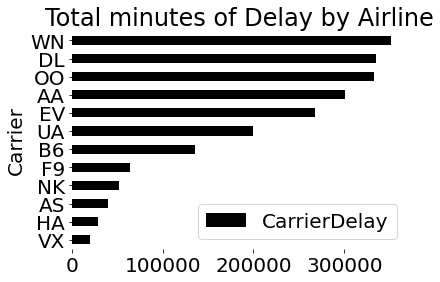

In [28]:
carrier_v_delay = air_perf[["CRSDepTime", "Carrier", "CarrierDelay"]].groupby('Carrier').sum().sort_values(by=['CarrierDelay'], ascending=True)

fig, ax = plt.subplots()

carrier_v_delay.plot(kind="barh", ax=ax, color="black")
ax.set_title("Total minutes of Delay by Airline")

for side in ["right", "top", "left", "bottom"]:
    ax.spines[side].set_visible(False)

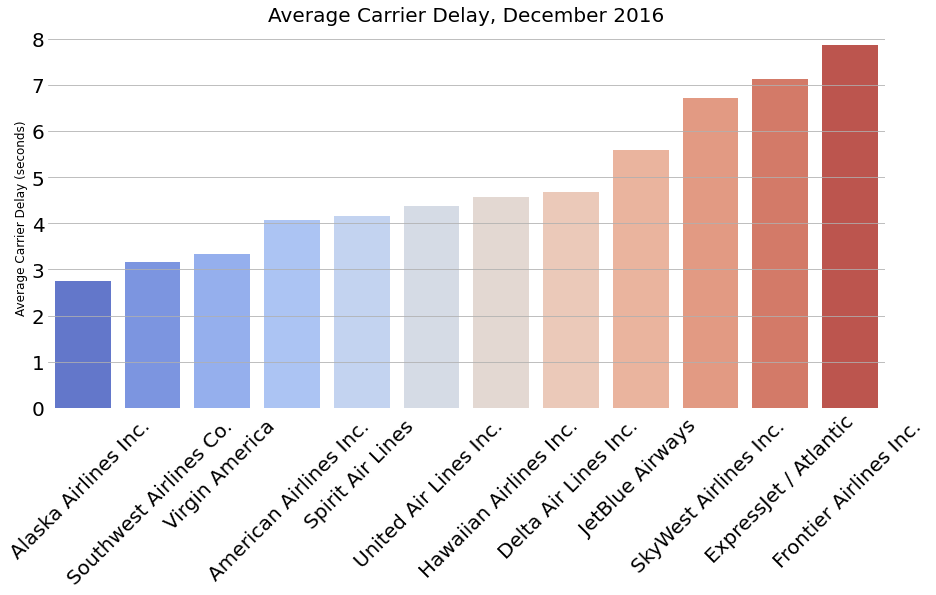

In [37]:
# get carrier description
carrier_code = qeds.load("airline_carrier_codes")
carrier_code['Description'] = carrier_code['Description'].str.split('(').str[0] # only interested in carrier name

# from Problem Set 6
df = air_perf.copy().groupby('Carrier').agg({'CarrierDelay': np.sum}) 
df['CarrierDelay'] = df['CarrierDelay']/(air_perf['Carrier'].value_counts()) # to find average delay per flight
df = df.rename(columns={'CarrierDelay':'AverageCarrierDelay'}).sort_values(by='AverageCarrierDelay',
                                                                           ascending=False).reset_index()
# get carrier description
carrier_code = qeds.load("airline_carrier_codes")
carrier_code['Description'] = carrier_code['Description'].str.split('(').str[0] # only interested in carrier name

# merge dfs
df = pd.merge(df, carrier_code, how='inner', left_on='Carrier', right_on=carrier_code.index)

# Combine ExpressJet and Atlantic
df.at[2, 'Description'] = 'ExpressJet / Atlantic'

# Drop ExpressJet and Aces Airlines (from Colombia)
df = df.drop([1, 11]).reset_index(drop=True)[['AverageCarrierDelay', 'Description']].sort_values('AverageCarrierDelay')
df.head()

# visualize AverageCarrierDelay and Carrier
fig, ax = plt.subplots(figsize=(15,7))

sns.barplot(x=df['Description'], y=df['AverageCarrierDelay'], palette='coolwarm', ax=ax)
plt.xticks(rotation=45)

# despine
for side in ["right", "top", "left", "bottom"]: 
    ax.spines[side].set_visible(False)

# remove ticks
ax.tick_params(axis=u'both', which=u'both',length=0)

# add horizontal gridlines
ax.yaxis.grid(True)

# title and axis labels
ax.set_title('Average Carrier Delay, December 2016', size=20)
ax.set_ylabel('Average Carrier Delay (seconds)', size=12);
ax.set_xlabel('');

Text(0.5, 1.0, 'Sum of Arrival Delays by Company for December in Minutes')

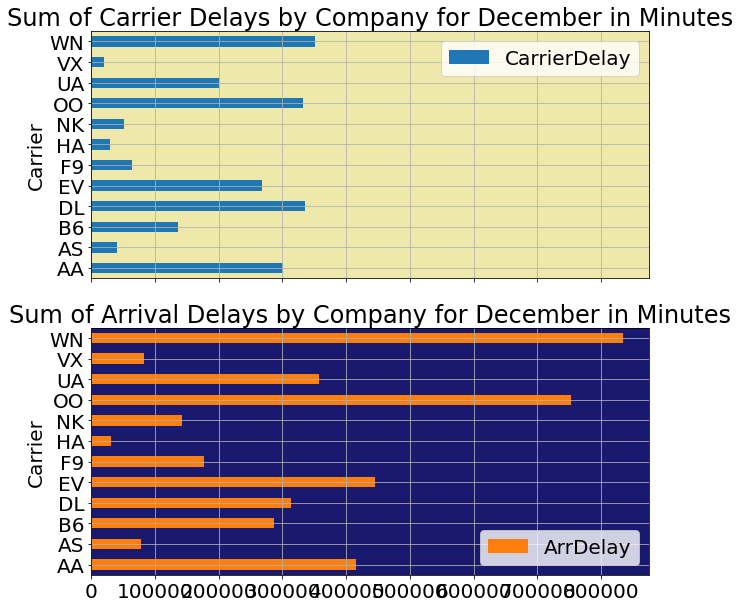

In [43]:
colors = ['r', 'lightseagreen']
fig, ax = (air_perf.groupby('Carrier')[['CarrierDelay', 'ArrDelay']].sum().plot(kind = 'barh', subplots = True, figsize = (10, 10),
                 grid = True))
fig.set_facecolor('palegoldenrod')
ax.set_facecolor('midnightblue')
fig.set_title("Sum of Carrier Delays by Company for December in Minutes")
ax.set_title("Sum of Arrival Delays by Company for December in Minutes")

### Question 4

Create a visualization of the relationship between date and delays.

Text(0.5, 1.0, 'Relationship between date and delays')

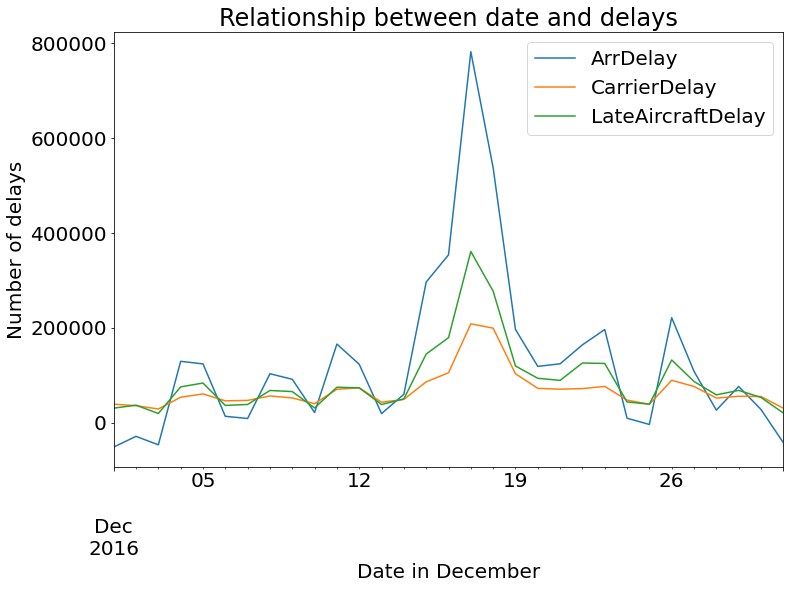

In [35]:
date_delay = air_perf.groupby('Date').sum()[['ArrDelay', 'CarrierDelay', 'LateAircraftDelay']]

fig, ax = plt.subplots(figsize = (12,8))
date_delay.plot(kind = 'line', ax=ax, subplots = False)
ax.set_ylabel("Number of delays")
ax.set_xlabel("Date in December")
ax.set_title("Relationship between date and delays")

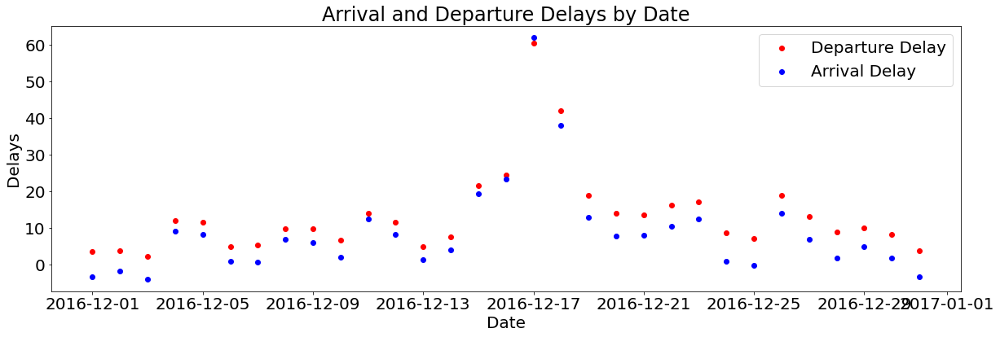

In [34]:
air_perf_filtered = air_perf[["Date","ArrDelay","DepDelay"]]


air_perf_data = air_perf_filtered.groupby("Date").mean()
fig,ax = plt.subplots(figsize = (20,6))

air_perf_date = air_perf_data.index.tolist()
DepDelay = air_perf_data["DepDelay"].tolist()
ArrDelay = air_perf_data["ArrDelay"].tolist()

dots1 = ax.scatter(air_perf_date, DepDelay, color = 'r', label = 'Departure Delay')
dots2 = ax.scatter(air_perf_date, ArrDelay, color = 'b', label = 'Arrival Delay')

ax.set_xlabel("Date")
ax.set_ylabel("Delays")
ax.set_title("Arrival and Departure Delays by Date")
ax.legend()


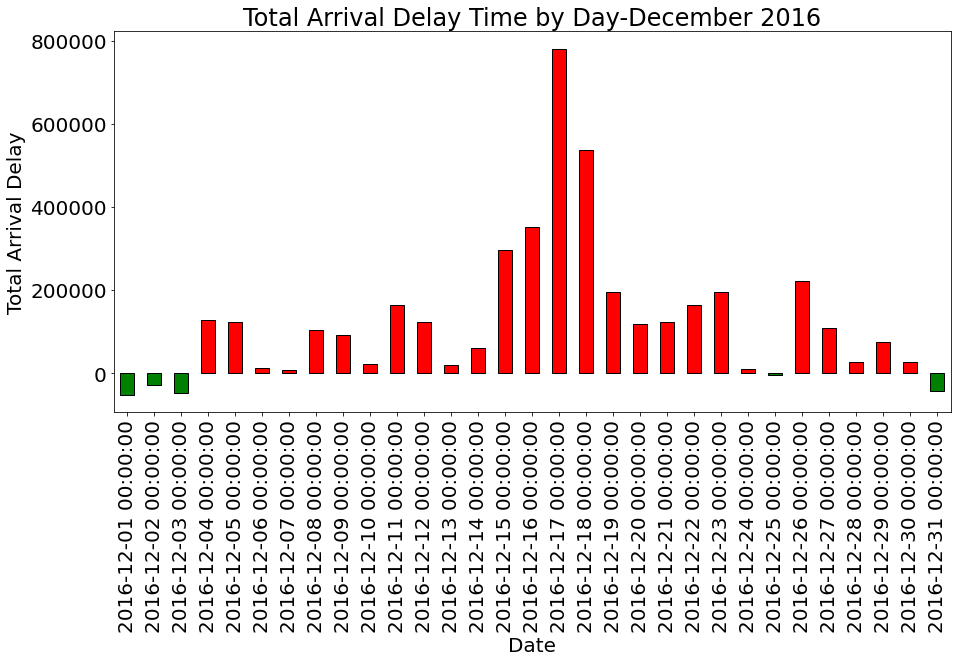

In [40]:
air_perf['Date'] = pd.to_datetime(air_perf['Date'])
ArrDelay_Grp = air_perf.groupby('Date').sum().ArrDelay
fig = plt.figure(figsize = (15,7))
ax = fig.add_subplot(111)
width = 0.5
clrs = ['green' if x < 0 else 'red' for x in ArrDelay_Grp]
ArrDelay_Grp.plot(kind='bar', color = clrs, edgecolor = 'black', ax=ax, width=width, align = 'center')
ax.set_ylabel('Total Arrival Delay')
plt.title('Total Arrival Delay Time by Day-December 2016')
plt.show()

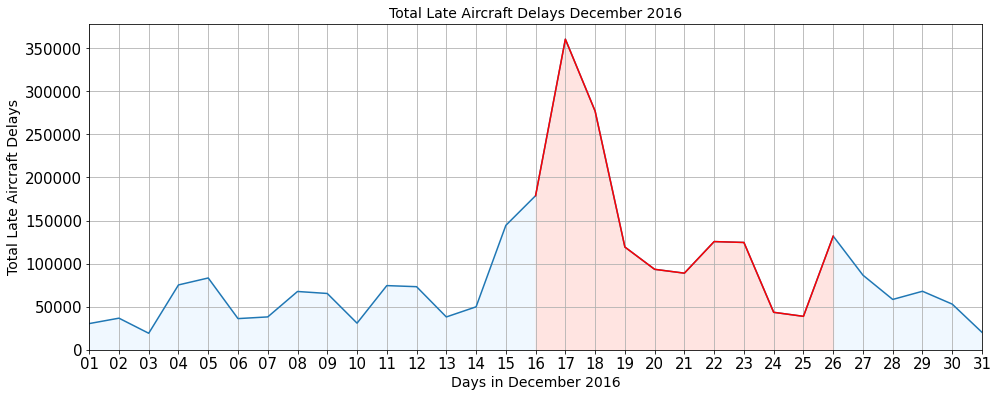

In [18]:
import matplotlib.dates as mdates
import datetime
air_perf_ddelay = air_perf[["Date","LateAircraftDelay"]].sort_values(by = "Date", ascending = True).set_index("Date").groupby(pd.Grouper(freq='D')).sum()
air_perf_ddelay["Day"] = air_perf_ddelay.index.day
air_perf_ddelay2 = air_perf_ddelay.copy()
air_perf_ddelay2.loc[(air_perf_ddelay2["Day"] < 16) | (air_perf_ddelay2["Day"] > 26), "LateAircraftDelay"] = np.nan
fig, ddy = plt.subplots(figsize = (16,6))

day = pd.date_range('2016-12-01', periods = 31, freq = "D")

ddy.plot(day, air_perf_ddelay["LateAircraftDelay"])
ddy.xaxis.set_major_locator(mdates.DayLocator())
ddy.xaxis.set_major_formatter(mdates.DateFormatter('%d'))
ddy.grid(b = True, axis = 'both')
ddy.fill_between(day,air_perf_ddelay["LateAircraftDelay"], color = "aliceblue")
ddy.plot(day, air_perf_ddelay2["LateAircraftDelay"], color = "red")
ddy.fill_between(day,air_perf_ddelay2["LateAircraftDelay"], color = "mistyrose")
ddy.set_ylim(ymin=0)
ddy.set_xlim([datetime.date(2016,12,1), datetime.date(2016,12,31)])
plt.title("Total Late Aircraft Delays December 2016", fontsize = 14)
plt.xlabel("Days in December 2016", fontsize = 14)
plt.ylabel("Total Late Aircraft Delays", fontsize = 14)

plt.show()

### Question 5

Create a visualization of the relationship between location (origin
and/or destination) and delays.

Text(0.5, 1.0, 'Horizontal Bar chart with relationship between Destinations and Delays (Stacked)')

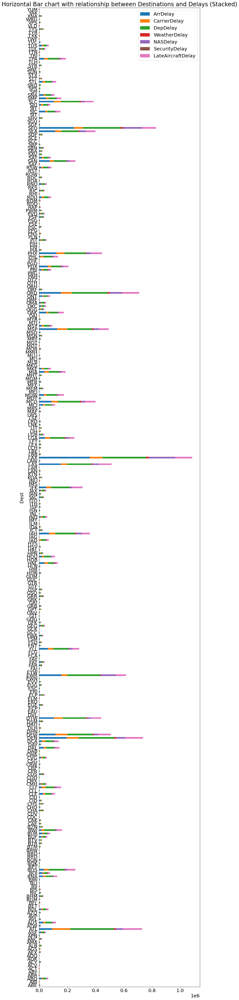

In [31]:
dest_delay = air_perf.groupby("Dest").sum()[["ArrDelay","CarrierDelay", "DepDelay", "WeatherDelay","NASDelay","SecurityDelay","LateAircraftDelay"]]
dest_delay.plot(kind="barh",subplots=False, stacked=True, figsize=(12,75))
plt.title("Horizontal Bar chart with relationship between Destinations and Delays (Stacked)")

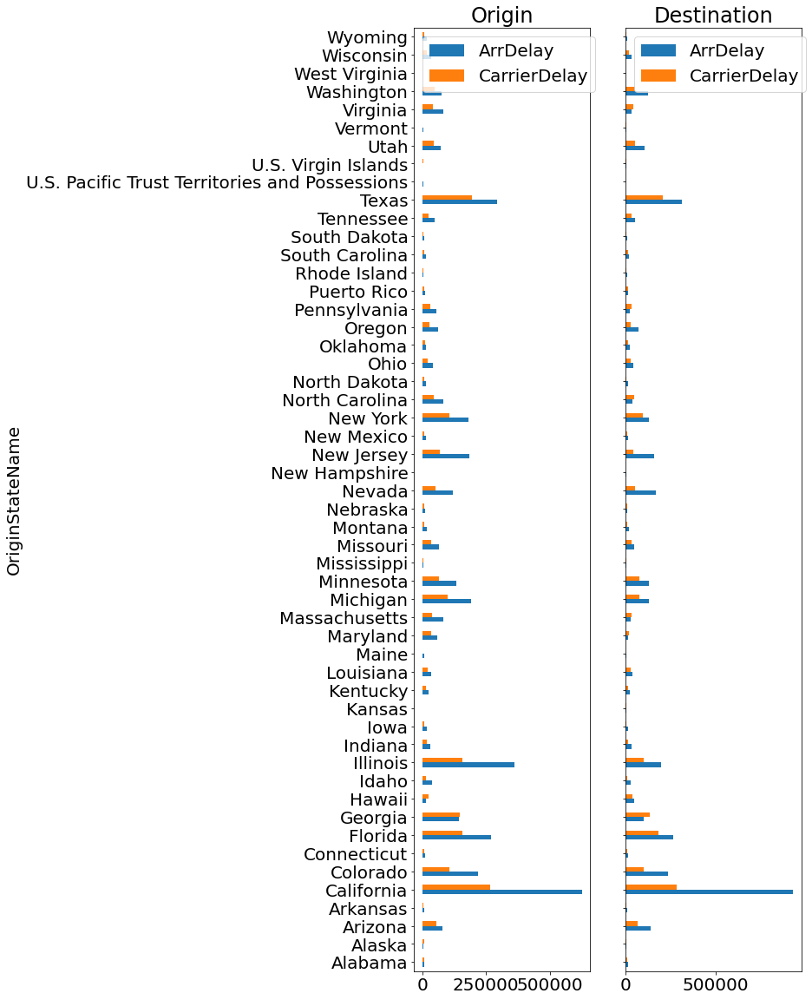

In [32]:
fig, ax= plt.subplots(1,2,sharey=True)
air_perf.groupby('OriginStateName').sum()[['ArrDelay','CarrierDelay']].plot(ax=ax[0],kind='barh',figsize=(8,20))
air_perf.groupby('DestStateName').sum()[['ArrDelay','CarrierDelay']].plot(ax=ax[1],kind='barh',figsize=(8,20))
ax[0].title.set_text('Origin')
ax[1].title.set_text('Destination')

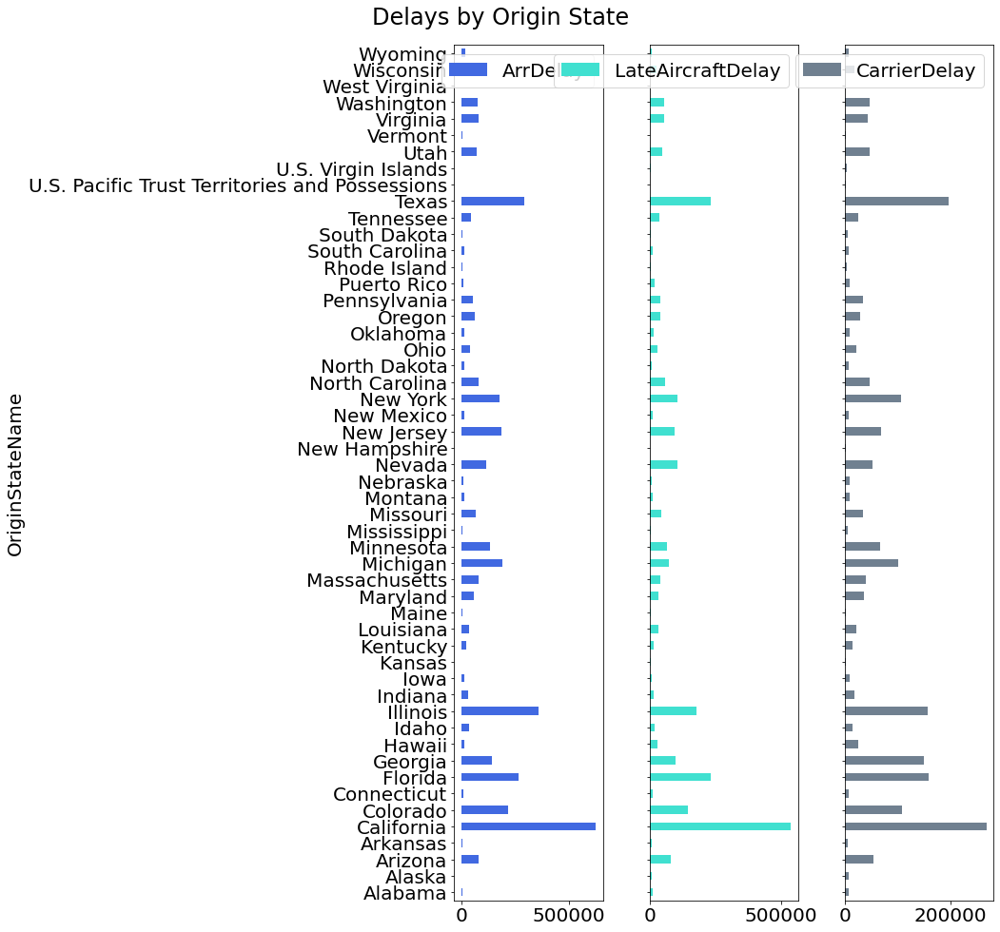

In [44]:
fig, ax = plt.subplots(1, 3, sharey=True, figsize=(15, 14)) 

air_perf.groupby('OriginStateName').sum()[['ArrDelay']].plot(kind="barh", ax=ax[0], color='royalblue').legend(loc=1)
air_perf.groupby('OriginStateName').sum()[['LateAircraftDelay']].plot(kind="barh", ax=ax[1], color='turquoise').legend(loc=1)
air_perf.groupby('OriginStateName').sum()[['CarrierDelay']].plot(kind="barh", ax=ax[2], color='slategrey').legend(loc=1)
fig.suptitle('Delays by Origin State')
fig.tight_layout()
fig.subplots_adjust(top=.94)

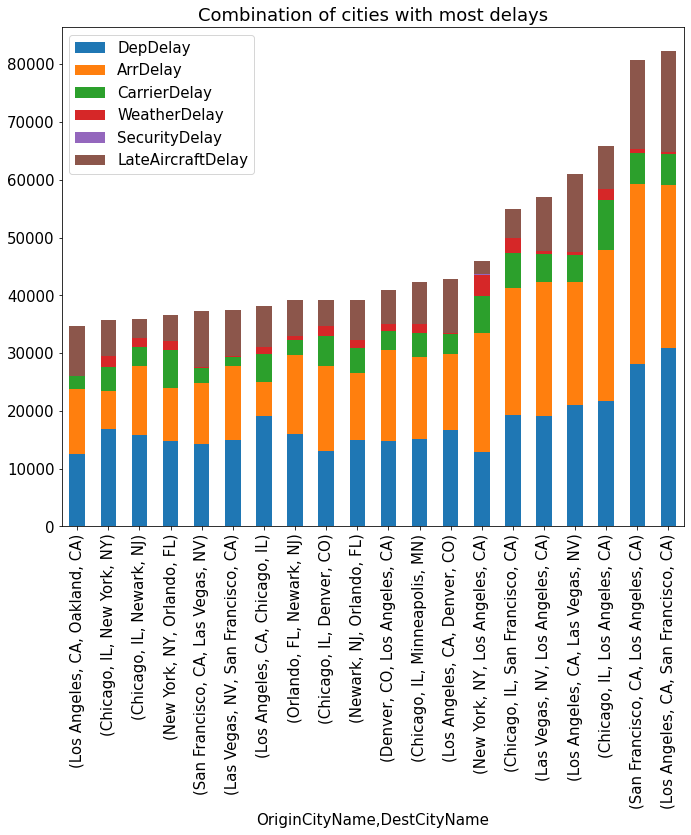

In [25]:
# Combinations of cities with most delays
df_adjust_1 = air_perf.groupby(['OriginCityName', 'DestCityName']).sum()[["DepDelay" ,
 "ArrDelay" , "CarrierDelay",  "WeatherDelay","SecurityDelay" , "LateAircraftDelay" ]]
df_adjust_1["total_delays"] = df_adjust_1.sum(axis = 1)
df_adjust_2 = df_adjust_1.sort_values("total_delays").tail(20)
df_5 = df_adjust_2[["DepDelay" ,
 "ArrDelay" , "CarrierDelay",  "WeatherDelay","SecurityDelay" , "LateAircraftDelay" ]]


def barplot5(df_5):

    fig, ax = plt.subplots(figsize=(10,12))
    df_5.plot(kind="bar", ax=ax , stacked=True , 
              title = "Combination of cities with most delays") 
    plt.rcParams.update({'font.size': 20})
    
    
    fig.tight_layout()
    
    return fig

barplot5(df_5);

Marginal difference between Brained, MN to Beaumont/Port Authur, TX, then a gradual increase up to Mammoth Lakes, CA. Followed by a dramatical increase in Pago Pago, TT


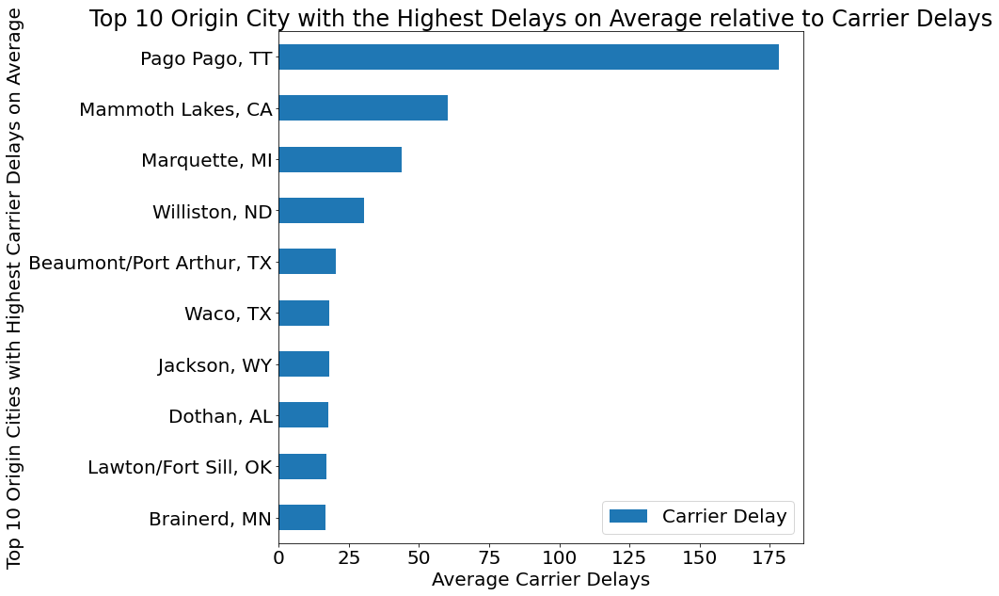

In [33]:
fig, ax = plt.subplots()
air_perf.groupby("OriginCityName").mean().sort_values("CarrierDelay").CarrierDelay.tail(10).plot.barh(legend = True, figsize = (10,10))

ax.set_xlabel('Average Carrier Delays')
ax.set_ylabel('Top 10 Origin Cities with Highest Carrier Delays on Average')
ax.set_title('Top 10 Origin City with the Highest Delays on Average relative to Carrier Delays')
ax.legend(["Carrier Delay"])

print(f"Marginal difference between Brained, MN to Beaumont/Port Authur, TX, then a gradual increase up to Mammoth Lakes, CA. Followed by a dramatical increase in Pago Pago, TT")

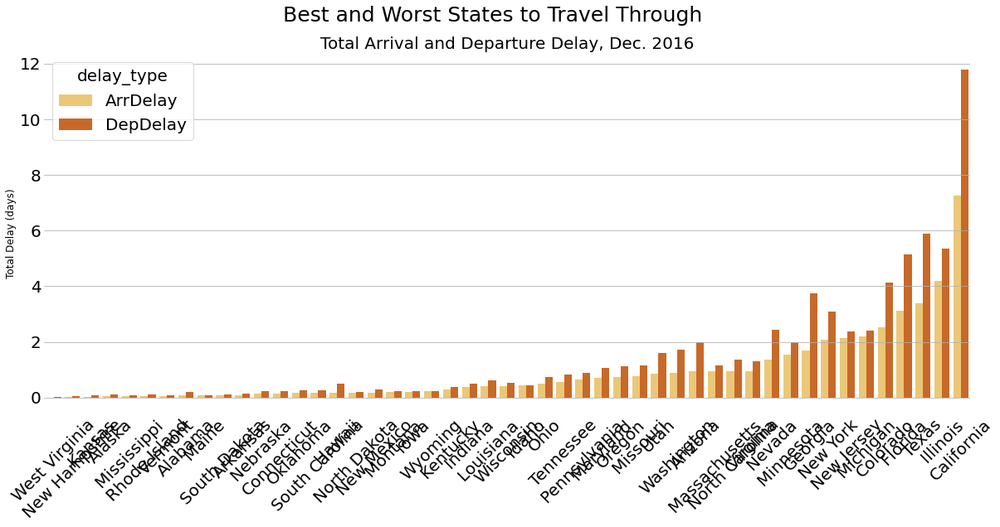

In [39]:
df = air_perf.copy()[['DepDelay', 'ArrDelay','OriginStateName']].groupby('OriginStateName').sum().sort_values(by=(['ArrDelay'] + ['DepDelay']),
                                                                                                              ascending=True).reset_index()

# drop non-states
df = df[(df['OriginStateName'] != 'U.S. Virgin Islands') & 
        (df['OriginStateName'] != 'U.S. Pacific Trust Territories and Possessions') &
        (df['OriginStateName'] != 'Puerto Rico')].reset_index(drop=True)

df = df.melt(id_vars='OriginStateName', value_vars=('ArrDelay', 'DepDelay')).rename(columns={'variable':'delay_type',
                                                                                             'value':'delay'})
df['delay'] = df['delay']/86400 # convert delay from seconds to days
df.head()

fig, ax = plt.subplots(figsize=(20, 8))

# sns.barplot(x=df['OriginStateName'], y=df['CarrierDelay'], palette='coolwarm', ax=ax)
sns.barplot(data=df, x='OriginStateName', y='delay', hue='delay_type', ax=ax, palette='YlOrBr')

# despine
for side in ["right", "top", "left", "bottom"]: 
    ax.spines[side].set_visible(False)
    
# axis and ticks
plt.xticks(rotation=45)
ax.tick_params(axis=u'both', which=u'both',length=0) # remove ticks
ax.yaxis.grid(True) # gridlines

#
plt.suptitle('Best and Worst States to Travel Through', size=25) # main title
ax.set_title('Total Arrival and Departure Delay, Dec. 2016', size=20) # subtitle
ax.set_ylabel('Total Delay (days)', size=12)
ax.set_xlabel('');

In [22]:
#!pip install --user wordcloud

     |████████████████████████████████| 371 kB 4.5 MB/s eta 0:00:01


In [24]:
from wordcloud import WordCloud
air_perf_wdelay = air_perf[["Origin", "WeatherDelay"]]

air_perf_wdelayc = air_perf_wdelay.copy()
air_perf_wdelayod = air_perf_wdelayc.set_index("Origin").groupby(["Origin"]).sum().sort_values(by = "WeatherDelay", ascending = True)
air_perf_wdelayoz = air_perf_wdelayc.set_index("Origin").groupby(["Origin"]).count().sort_values(by = "WeatherDelay", ascending = True)

air_merge = pd.merge(air_perf_wdelayoz, air_perf_wdelayod, on="Origin")

air_merge["WheatherDelayProportional"] = air_merge["WeatherDelay_y"]/air_merge["WeatherDelay_x"]

air_merge_f = air_merge.drop(["WeatherDelay_x", "WeatherDelay_y"], axis = 1)

dict_word = dict(zip(air_merge_f.index.tolist(), air_merge_f["WheatherDelayProportional"].tolist()))

wordcloud = WordCloud(max_words = 297, background_color = 'white', colormap = 'cividis').generate_from_frequencies(dict_word)

In [26]:
plt.figure(figsize = (320, 320))
plt.title("Flight Origin by Weather Delay - Controlled for Number of Flights Departing", fontsize = 100)
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis("off")
plt.show()

Text(0.5, 0, 'Travel distance ranges in km')

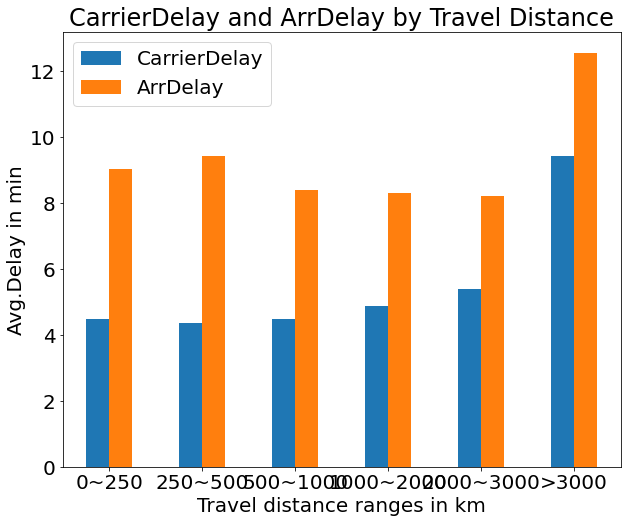

In [42]:
bins = [0, 250, 500, 1000, 2000, 3000, np.inf ]
names = ["0~250", "250~500", "500~1000", "1000~2000", "2000~3000", ">3000"]

air_perf['Dist'] = pd.cut(air_perf['Distance'], bins, labels = names)
avg_delays4 = air_perf.groupby('Dist').mean().sort_values('Dist')
avg_delays5 = avg_delays4.drop(["Distance"], axis = 1)[['CarrierDelay','ArrDelay']]
loc_dist = avg_delays5.plot.bar(figsize=(10, 8))
plt.xticks(rotation = 'horizontal')
loc_dist.set_title("CarrierDelay and ArrDelay by Travel Distance")
loc_dist.set_ylabel('Avg.Delay in min')
loc_dist.set_xlabel('Travel distance ranges in km')